In [1]:
import csv
import numpy as np
import os

In [4]:
predicted = 'predicted_densenet_mosquitobrass_3_2_1920.csv' #'predicted.csv'
names = 'MosquitoBrass_TEST.csv' #'waterwind_test.csv'
class0 = 'Mosquito' #water
class1 = 'Brass' #wind

In [5]:
data = open(names,'r').readlines()
namelist = []
classcolors = []
paramcolors = []
param2colors = []
for row in data[1:]:
    name = row.split(',')[0]
    namelist.append(name)
    if class0 in name:
        # print(name)
        param2 = float(name.split('--')[2].split('-')[1].replace('.wav','')) #busybody
        param = float(name.split('--')[1].split('-')[1]) # cf
        classcolors.append(0)
        paramcolors.append(int(param*10))
        param2colors.append(int(param2*10))
        
    else:
        param = round((int(name.split('-')[1])-64)/(76-64),1)
        classcolors.append(1)
        paramcolors.append(int(param*10)) 
        param2colors.append(int(param*10)) 
print(np.shape(namelist))
# print(namelist)

(220,)


In [6]:
data = csv.reader(open(predicted,'r'))
subset_len = 1920
for_pca = np.array([])
for row in data:
    row_sub = row[:subset_len]
    if for_pca.size:
        for_pca = np.vstack((for_pca,np.array(row_sub)))
    else:
        for_pca = np.array(row_sub)
print(np.shape(for_pca))

(220, 1920)


In [7]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(for_pca)
print(np.shape(principalComponents[:,0]))

(220,)


## Color-coding with class - purple (mosquito) and yellow (brass)

Text(0.5, 0.92, 'Principal Components of 1920 outputs of VGGish')

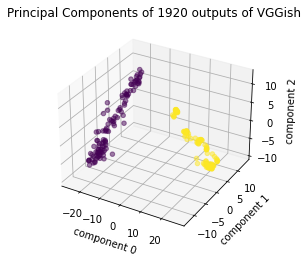

In [8]:
import matplotlib.pylab as plt
ax = plt.axes(projection='3d')
scatter = ax.scatter3D(principalComponents[:,0], principalComponents[:,1], principalComponents[:,2],c=classcolors,alpha=0.5)
plt.xlabel('component 0')
plt.ylabel('component 1')
ax.set_zlabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

## Color-coding with center-frequency (mosquito) and pitch (brass)

Text(0.5, 0.92, 'Principal Components of 1920 outputs of VGGish')

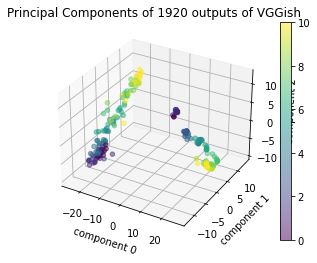

In [9]:
ax = plt.axes(projection='3d')
scatter = ax.scatter3D(principalComponents[:,0], principalComponents[:,1], principalComponents[:,2],c=paramcolors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 0')
plt.ylabel('component 1')
ax.set_zlabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

Text(0.5, 1.0, 'Principal Components of 1920 outputs of VGGish')

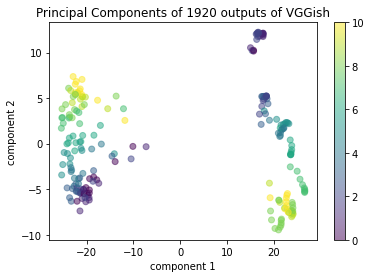

In [10]:
ax = plt.axes()
scatter = ax.scatter(principalComponents[:,0], principalComponents[:,2],c=paramcolors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

## Color-coding with busy-body (mosquito) and pitch (brass)

Text(0.5, 0.92, 'Principal Components of 1920 outputs of VGGish')

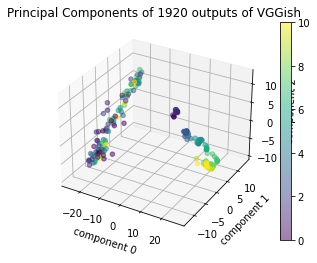

In [11]:
ax = plt.axes(projection='3d')
scatter = ax.scatter3D(principalComponents[:,0], principalComponents[:,1], principalComponents[:,2],c=param2colors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 0')
plt.ylabel('component 1')
ax.set_zlabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

Text(0.5, 1.0, 'Principal Components of 1920 outputs of VGGish')

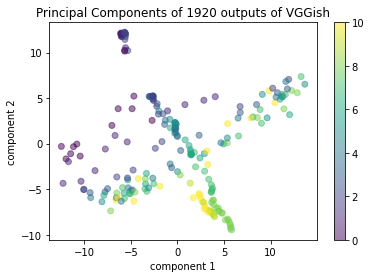

In [12]:
ax = plt.axes()
scatter = ax.scatter(principalComponents[:,1], principalComponents[:,2],c=param2colors,alpha=0.5)
plt.colorbar(scatter)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.title('Principal Components of 1920 outputs of VGGish')

In [13]:
def ReorderNames(elem):
    return int(elem.split('_')[-1].replace('.wav',''))

In [14]:
import glob
import soundfile as sf
import librosa
def GetMergedAudioFile(folder,audio):
    filelist = glob.glob(folder+'/*.wav')
    filelist.sort(key=ReorderNames)
    # print(filelist)
    dataarray = np.array([])
    fs = 16000
    sublen = 1.5 #seconds
    silence = 0.2 #seconds
    sil_arr = [0]*int(silence*fs)
    
    for filename in filelist:
        x, sr = librosa.load(filename,duration=sublen, sr = fs)
        dataarray = np.append(dataarray,x)
        dataarray = np.append(dataarray,sil_arr)
    sf.write(audio,dataarray,sr,subtype='PCM_16')

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [15]:
import warnings
warnings.filterwarnings("ignore")
def showSpecgram(audio,text):
    FS=16000
    plt.figure()
    data,fs = librosa.load(audio,sr = FS)
    spec = plt.specgram(data, Fs=FS, NFFT=1024, cmap="rainbow")
    # plt.xlabel("Time (s)",fontsize=20)
    # plt.ylabel("Frequency",fontsize=20)
    # print(np.shape(spec[0]),len(xvals))
    plt.xticks([])
    plt.yticks([])
    # plt.xticks(fontsize=15) #,labels=xvals)
    # plt.yticks(fontsize=15)
    plt.ylim(0,8000)
    plt.xlabel(text+' varying -->')
    plt.tight_layout()
    # plt.show()

# GAN Synthesis with pca_0, pca_1, and pca_2 as conditioning values

In [16]:
import os
import IPython.display as ipd
audiomergedfolder = 'audiomergedfolder_mosquitobrass'
if not os.path.exists(audiomergedfolder):
    os.mkdir(audiomergedfolder)

## Varying pca_0 conditioning dimension

Run  0


Run  1


Run  2


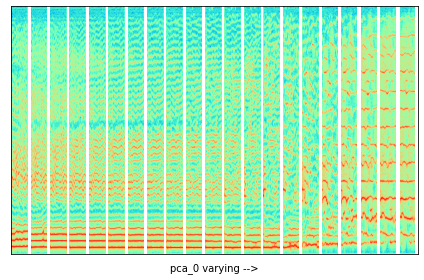

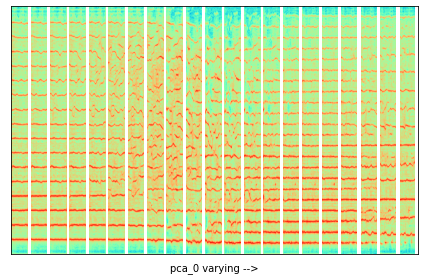

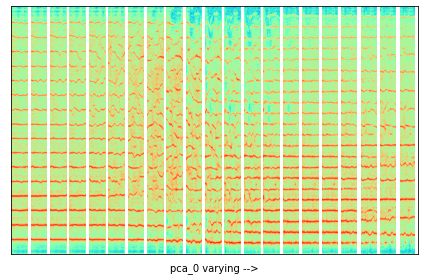

In [17]:
folders = ['audiofiles_mosquitobrass/varyComp0_initMosquito_equispaced20','audiofiles_mosquitobrass/varyComp0_initBrass_equispaced20','audiofiles_mosquitobrass/varyComp0_initBrass2_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_0')
    run = run+1
    

## Varying pca_1 conditioning dimension, choosing 'Mosquito' class in pca_0

Run  0


Run  1


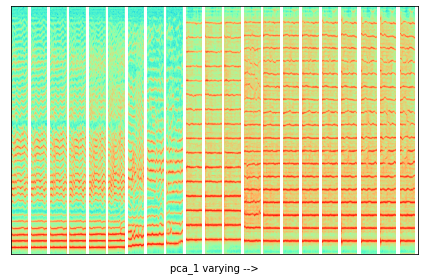

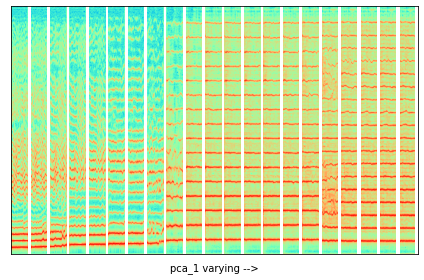

In [16]:
folders = ['audiofiles_mosquitobrass/varyComp1_initMosquito_equispaced20','audiofiles_mosquitobrass/varyComp1_initMosquito_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_1')
    run = run+1

## Varying pca_2 conditioning dimension, choosing 'Brass' class in pca_0

Run  0


Run  1


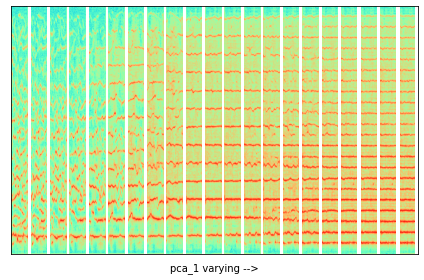

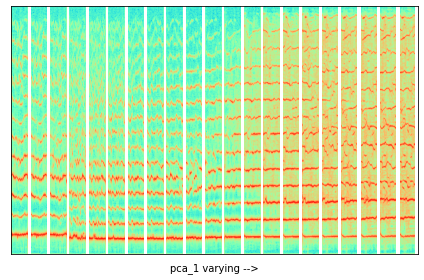

In [25]:
folders = ['audiofiles_mosquitobrass/varyComp2_initBrass_equispaced20','audiofiles_mosquitobrass/varyComp2_initBrass_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
for folder in folders:
    print('Run ',run)
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,'pca_1')
    run = run+1

## Choosing [0,0,0] as the initial point, and varying in pca_0, pca_1, and pca2 directions (UNTRAINED SCENARIO) - RUN 0

pca_0


pca_1


pca_2


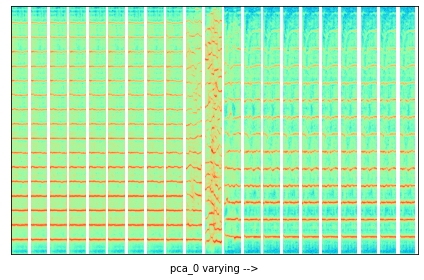

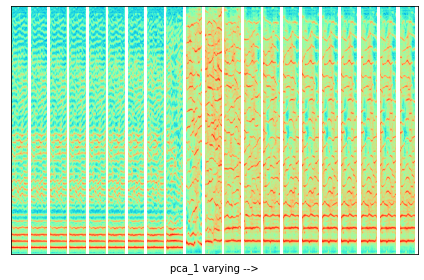

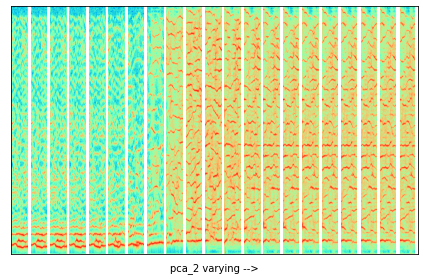

In [37]:
folders = ['audiofiles_mosquitobrass/untrained_directions/varyComp0_init0.0_equispaced20','audiofiles_mosquitobrass/untrained_directions/varyComp1_init0.0_equispaced20','audiofiles_mosquitobrass/untrained_directions/varyComp2_init0.0_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1

pca_0


pca_1


pca_2


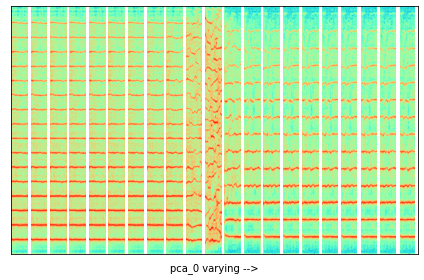

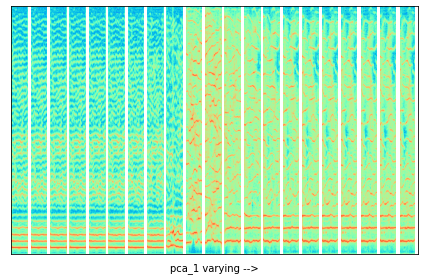

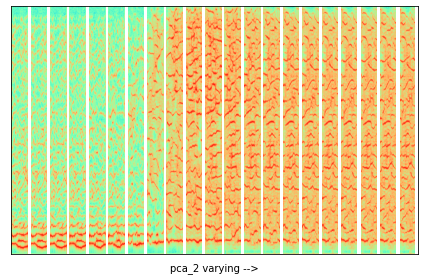

In [18]:
folders = ['audiofiles_mosquitobrass/untrained_directions/varyComp0_init0.0_equispaced20_v2','audiofiles_mosquitobrass/untrained_directions/varyComp1_init0.0_equispaced20_v2','audiofiles_mosquitobrass/untrained_directions/varyComp2_init0.0_equispaced20_v2']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1

# Changing starting point to [-10, -10, -10]

pca_0


pca_1


pca_2


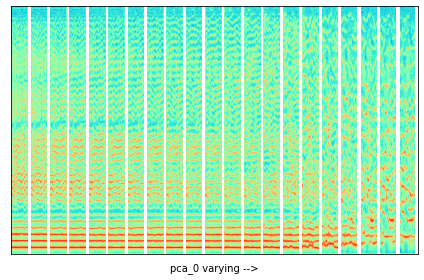

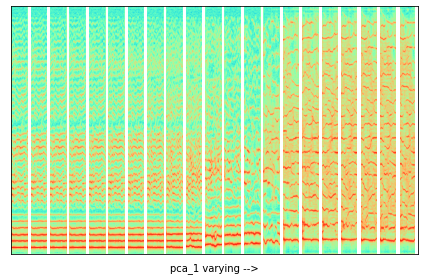

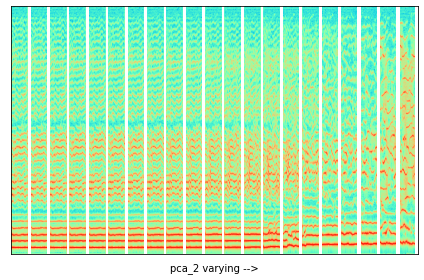

In [20]:

folders = ['audiofiles_mosquitobrass/untrained_directions/varyComp0_init-10.0_equispaced20','audiofiles_mosquitobrass/untrained_directions/varyComp1_init-10.0_equispaced20','audiofiles_mosquitobrass/untrained_directions/varyComp2_init-10.0_equispaced20']
sub = 'one_z_pitch_sweep'
run = 0
pcas = ['pca_0','pca_1','pca_2']
for folder in folders:
    # print('Run ',run)
    print(pcas[run])
    src_folder = folder+os.sep+sub
    dest_audio = audiomergedfolder+os.sep+folder.split(os.sep)[-1]+'.wav'
    GetMergedAudioFile(src_folder,dest_audio)
    ipd.display(ipd.Audio(dest_audio))
    # minimum = np.min(principalComponents[:,0])
    # maximum = np.max(principalComponents[:,0])
    # step = (maximum-minimum)/20
    # xvals = np.arange(minimum,maximum,step)
    showSpecgram(dest_audio,pcas[run])
    run = run+1